In [96]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from phik import phik_matrix
import warnings 
from joblib import dump, load
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns',None)
plt.style.use('dark_background')
sns.set_style('darkgrid')
random_state = 42

## Описание данных

- **diagnosis** - диагностика тканей молочной железы
- **radius_mean** - среднее расстояние от центра ядра до контура. 
- **texture_mean** - стандартное отклонение серого уровня
- **perimeter_mean** - средний Периметр ядра
- **area_mean** - средняя Площадь ядра
- **smoothness_mean** - средняя локальная изменчивость радиуса
- **compactness_mean** - средняя плотность формы
- **concavity_mean** - средняя вогнутость
- **concave points_mean** - среднее кол-во вогнутых точек на контуре
- **symmetry_mean** -средняя симметрия ядра относительно центра
- **fractal_dimension_mean**  - Средняя фрактальная размерность контура
- **radius_se** - Ошибка радиуса
- **texture_se** - Ошибка текстуры
- **perimeter_se** - Ошибка периметра
- **area_se** - Ошибка площади
- **smoothness_se** - Ошибка гладкости
- **compactness_se** - Ошибка компактности
- **concavity_se** - Ошибка вогнутости
- **concave points_se** - Ошибка числа вогнутых точек
- **symmetry_se** - Ошибка симметрии
- **fractal_dimension_se** - Ошибка фрактальной размерности
- **radius_worst** - Наибольший радиус
- **texture_worst** - Наибольшая текстура
- **perimeter_worst** - Наибольший периметр
- **area_worst** - Наибольшая площадь
- **smoothness_worst** - Наименьшая гладкость 
- **compactness_worst** - Наибольшая компактность
- **concavity_worst** - Наибольшая вогнутость
- **concave points_worst** - Макс. число вогнутых точек
- **symmetry_worst** - Наименьшая симметрия
- **fractal_dimension_worst** - Наибольшая фрактальная размерность

In [118]:
df.columns

Index(['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

## Итоговый Пайплайн

In [1]:
%%writefile prepare.py

import pandas as pd

class PrepareData:
    def __init__(self, path):
        self.path = path
    def transform_dataset(self):
        df = pd.read_csv(self.path)
        df.columns = self.prepare_cols(df.columns)
        ids = df['id'].copy() # Сохраняем id
        df.dropna(axis = 1, inplace = True, thresh=0.9*df.shape[0])
        df['diagnosis'] = df['diagnosis'].apply(lambda x: 1 if x == 'M' else 0)
        df.drop(['id','radius_mean','concavity_mean','texture_se','concavity_worst'], inplace = True, axis = 1)
        return df,ids
    @staticmethod
    def prepare_cols(cols):
       return list(col.strip().replace(' ','_') for col in cols)

Writing prepare.py


In [2]:
%%writefile final_model.py

from joblib import load
import pandas as pd
import numpy as np


class FinalModel:
    def __init__(self, path_selector, path_main_model):
        self.selector = load(path_selector)
        self.model = load(path_main_model)

    def predict(self,X):
        self.get_features(X)
        return self.model.predict(self.dataset)

    def predict_proba(self,X):
        self.get_features(X)
        return self.model.predict_proba(self.dataset)[:,1]
        
    def get_features(self,X):
        X = self.selector.transform(X)
        self.dataset = pd.DataFrame(X, columns = self.selector.get_feature_names_out())

Writing final_model.py


## ETL

In [4]:
%%writefile 01_prepare.py
import argparse,pathlib,logging
from prepare import PrepareData

logging.basicConfig(level=logging.INFO)
p = argparse.ArgumentParser()

p.add_argument('--input',required=True)
p.add_argument('--ids_out', required=True)
p.add_argument('--feat_out', required=True)
args = p.parse_args()

feats, ids = PrepareData(args.input).transform_dataset()
pathlib.Path(arg.ids_out).parent.mkdir(parents=True, exist_ok=True)
ids.to_csv(args.ids_out, index=False, header=False)
feats.to_parquet(args.feat_out, index=False)
logging.info("PREPARED: ids=%s  feats=%s", ids.shape, feats.shape)

Writing 01_prepare.py


In [5]:
%%writefile 02_predict.py
import argparse, pathlib, logging, pandas as pd
from final_model import FinalModel

logging.basicConfig(level=logging.INFO)
p = argparse.ArgumentParser()
p.add_argument('--feat', required=True)
p.add_argument('--selector', required=True)
p.add_argument('--model', required=True)
p.add_argument('--proba_out', required=True)
args = p.parse_args()

X = pd.read_parquet(args.feat)
fm = FinalModel(args.selector, args.model)
proba = fm.predict_proba(X)

pathlib.Path(args.proba_out).parent.mkdir(parents=True, exist_ok=True)
pd.Series(proba).to_csv(args.proba_out, index=False, header=False)
logging.info("PREDICT: %d rows → %s", len(proba), args.proba_out)

Writing 02_predict.py


In [3]:
%%writefile 03_make_csv.py
import argparse, pathlib, logging, pandas as pd, datetime as dt

logging.basicConfig(level=logging.INFO)
p = argparse.ArgumentParser()
p.add_argument('--ids',    required=True)
p.add_argument('--proba',  required=True)
p.add_argument('--dst_dir', required=True)
args = p.parse_args()

ids_df   = pd.read_csv(args.ids, header=None)
proba_df = pd.read_csv(args.proba, header=None)
ids   = ids_df.iloc[:, 0]
proba = proba_df.iloc[:, 0]


submit = pd.DataFrame({'id': ids, 'prediction': proba})

ts   = dt.datetime.now().strftime('%Y%m%d_%H%M%S')
file = pathlib.Path(args.dst_dir) / f"submission_{ts}.csv"
file.parent.mkdir(parents=True, exist_ok=True)
submit.to_csv(file, index=False)
logging.info("SUBMISSION saved → %s", file)

Writing 03_make_csv.py


In [1]:
%%writefile inference_dag.py
from airflow import DAG
from airflow.operators.bash import BashOperator
from datetime import datetime
from airflow.decorators import task
from datetime import datetime
repo = "/home/alex_kondrashov7/Экзамен Инжиниринг"
etl  = f"{repo}/etl"
with DAG (dag_id='breast_cancer_inference', schedule_interval= '* * * * *',start_date=datetime(2025, 6, 15), catchup=False) as dag:
    prepare = BashOperator(task_id='prepare',
                           bash_command=(
                               f"python {etl}/01_prepare.py " f"--input {repo}/data.csv " f"--ids_out {repo}/ids.csv "f"--feat_out {repo}/feats.parquet"))

    
    predict = BashOperator(task_id='predict',
            bash_command=(f"python {etl}/02_predict.py "f"--feat {repo}/feats.parquet "f"--selector {repo}/selector_model.pkl "f"--model {repo}/voting_model.pkl "f"--proba_out {repo}/proba.csv")
    )

    submit = BashOperator(task_id='make_csv',
            bash_command=(f"python {etl}/03_make_csv.py " f"--ids {repo}/ids.csv " f"--proba {repo}/proba.csv " f"--dst_dir {repo}/results")
    )

    prepare >> predict >> submit

Writing inference_dag.py


In [10]:
repo

'/home/alex_kondrashov7/Экзамен Инжиниринг'

In [3]:
r = PrepareData('data.csv')
df = r.transform_dataset()

In [97]:
class Vizualization:
    def __init__(self,df):
        self.df = df
        self.float_cols = [col for col in self.df.columns if self.df[col].dtype == 'float']
        self.target_column = [col for col in self.df.columns if self.df[col].dtype == 'int']
    def histograms(self,rows = 13, cols = 2):
        fig,axes = plt.subplots(ncols=cols,nrows=rows,figsize = (30,30))
        plt.subplots_adjust(hspace=0.6,wspace=0.4)
        axes = axes.flatten()
        for i,col in enumerate(self.float_cols):
            sns.histplot(self.df[col], ax=axes[i])
            axes[i].set_title(f'Гистограмма распределения для признака {col}')
        plt.show()

    def pie(self):
        palette = {1: 'red', 0: 'green'}                     
        label_map = {0: 'Доброкачеств.', 1: 'Злокачеств.'}   
    
        for col in self.target_column:
            results = self.df[col].value_counts(normalize=True)
    
            colors = [palette[val] for val in results.index]
            labels = [label_map[val] for val in results.index]
    
            plt.figure(figsize=(4, 4))                       
            plt.pie(results.values,
                    labels=labels,       
                    autopct='%2.2f%%',
                    colors=colors,
                    textprops={'fontsize': 10})
            plt.title(f'Соотношение {col}')
    
        plt.show()

    def heatmap(self):
        matrix = self.df.phik_matrix(interval_cols = self.float_cols)
        plt.figure(figsize=(30,30))
        sns.heatmap(matrix, annot=True, cmap='rainbow')
        plt.title('Матрица корреляции')
        plt.show()

    def boxplot(self):
        fig, axes = plt.subplots(nrows=13, ncols=2, figsize=(15,40))
        plt.subplots_adjust(hspace=0.4,wspace=0.4)
        axes = axes.flatten()
        target = 'diagnosis'
        label_map = {0: 'Доброкачеств.', 1: 'Злокачеств.'}
        for i,col_fl in enumerate(self.float_cols):
            sns.boxplot(x = self.df[target], y = self.df[col_fl], ax = axes[i])
            axes[i].set_xticklabels([label_map[0], label_map[1]], fontsize=9)
        plt.show()

    
class FinalModel:
    def __init__(self, path_selector, path_main_model):
        self.selector = load(path_selector)
        self.model = load(path_main_model)

    def predict(self,X):
        self.get_features(X)
        return self.model.predict(self.dataset)

    def predict_proba(self,X):
        self.get_features(X)
        return self.model.predict_proba(self.dataset)[:,1]
        
    def get_features(self,X):
        X = self.selector.transform(X)
        self.dataset = pd.DataFrame(X, columns = self.selector.get_feature_names_out())

In [98]:
madel = FinalModel('selector_model.pkl','voting_model.pkl')
y = madel.predict(X_val)

## Загрузка данных

In [19]:
df = pd.read_csv('data.csv')
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [20]:
df.dropna(axis = 1, inplace = True, thresh=0.9*df.shape[0])

In [152]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 27 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    int64  
 1   texture_mean             569 non-null    float64
 2   perimeter_mean           569 non-null    float64
 3   area_mean                569 non-null    float64
 4   smoothness_mean          569 non-null    float64
 5   compactness_mean         569 non-null    float64
 6   concave points_mean      569 non-null    float64
 7   symmetry_mean            569 non-null    float64
 8   fractal_dimension_mean   569 non-null    float64
 9   radius_se                569 non-null    float64
 10  perimeter_se             569 non-null    float64
 11  area_se                  569 non-null    float64
 12  smoothness_se            569 non-null    float64
 13  compactness_se           569 non-null    float64
 14  concavity_se             5

In [124]:
cols_object = [col for col in df.columns if df[col].dtype == 'object']
cols_float = [col for col in df.columns if df[col].dtype == 'float']

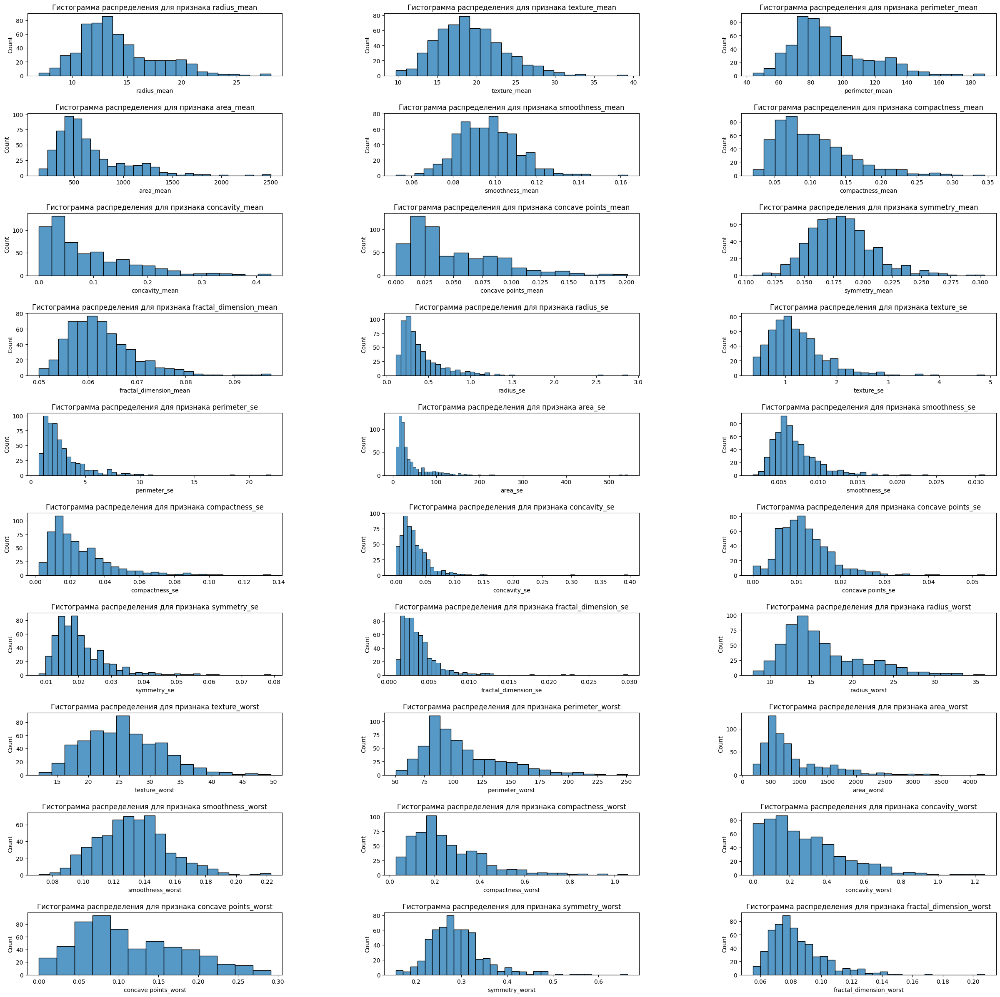

In [59]:
fig,axes = plt.subplots(ncols=3,nrows=10,figsize = (30,30))
plt.subplots_adjust(hspace=0.6,wspace=0.4)
axes = axes.flatten()
for i,col in enumerate(cols_float):
    sns.histplot(df[col], ax=axes[i])
    axes[i].set_title(f'Гистограмма распределения для признака {col}')
    

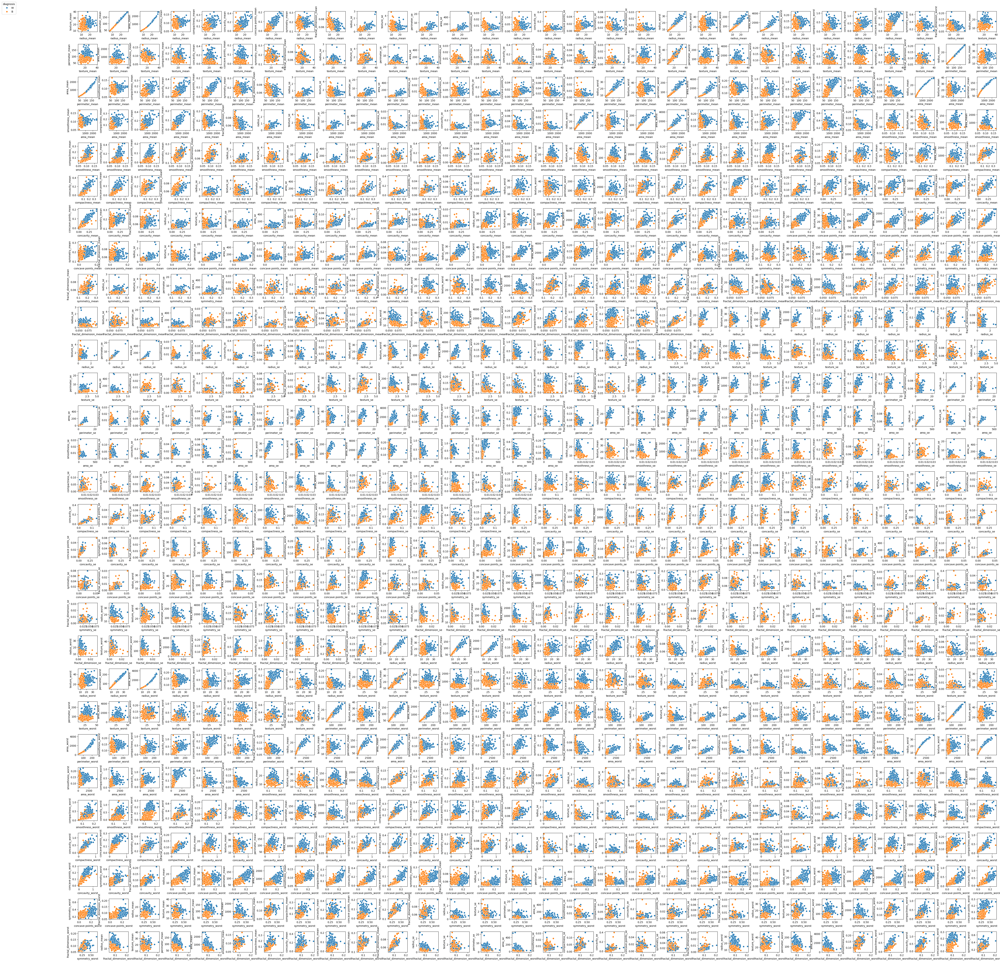

In [89]:
import math
needed = len(cols_float)*(len(cols_float)-1)
cols = 30           
rows = math.ceil(needed/cols)
fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(cols*2, rows*2))


check_cols = {col:False for col in cols_float}
axes = axes.flatten()
i = 0
for target in cols_object:
    for col1 in cols_float:
        for col2 in cols_float:
            if col1 != col2 and not check_cols[col1]:
                sns.scatterplot(x = df[col1],y = df[col2], hue=df[target], ax=axes[i], legend = True if i == 0 else False)
                i+=1
        check_cols[col1] = True



ax0 = axes[0]                             
leg = ax0.get_legend()

if leg:
    leg.set_bbox_to_anchor((0, 1),   transform=fig.transFigure)
    leg.set_frame_on(True)                 
    leg.set_title('diagnosis')
    leg._loc = 2                           


plt.subplots_adjust(left=0.07, top=0.99,
                    hspace=0.60, wspace=0.60)


plt.show()                

/tmp/ipykernel_962/1876467163.py:2 FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

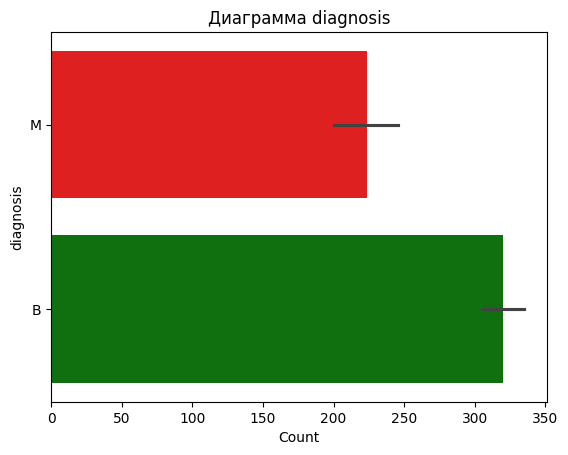

In [97]:
for col in cols_object:
    sns.barplot(df[col], palette= {'M': 'red', 'B' : 'green'})
    plt.xlabel('Count')
    plt.title(f'Диаграмма {col}')
plt.show()

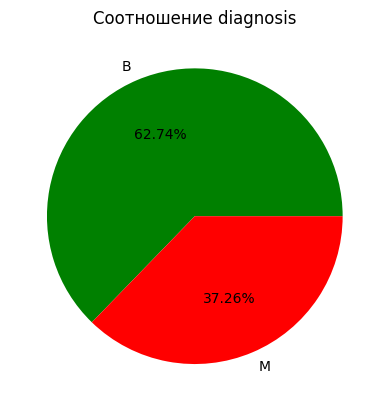

In [104]:
palette= {'M': 'red', 'B' : 'green'}

for col in cols_object:
    results =df[col].value_counts(normalize=True)
    color = [palette[lbl] for lbl in results.index]
    plt.pie(results.values, labels=results.index,autopct='%2.2f%%', colors=color)
    plt.title(f'Соотношение {col}')

In [111]:
df['diagnosis'] = df['diagnosis'].apply(lambda x: 1 if x == 'M' else 0)


In [115]:
df.drop('id', axis = 1, inplace = True)

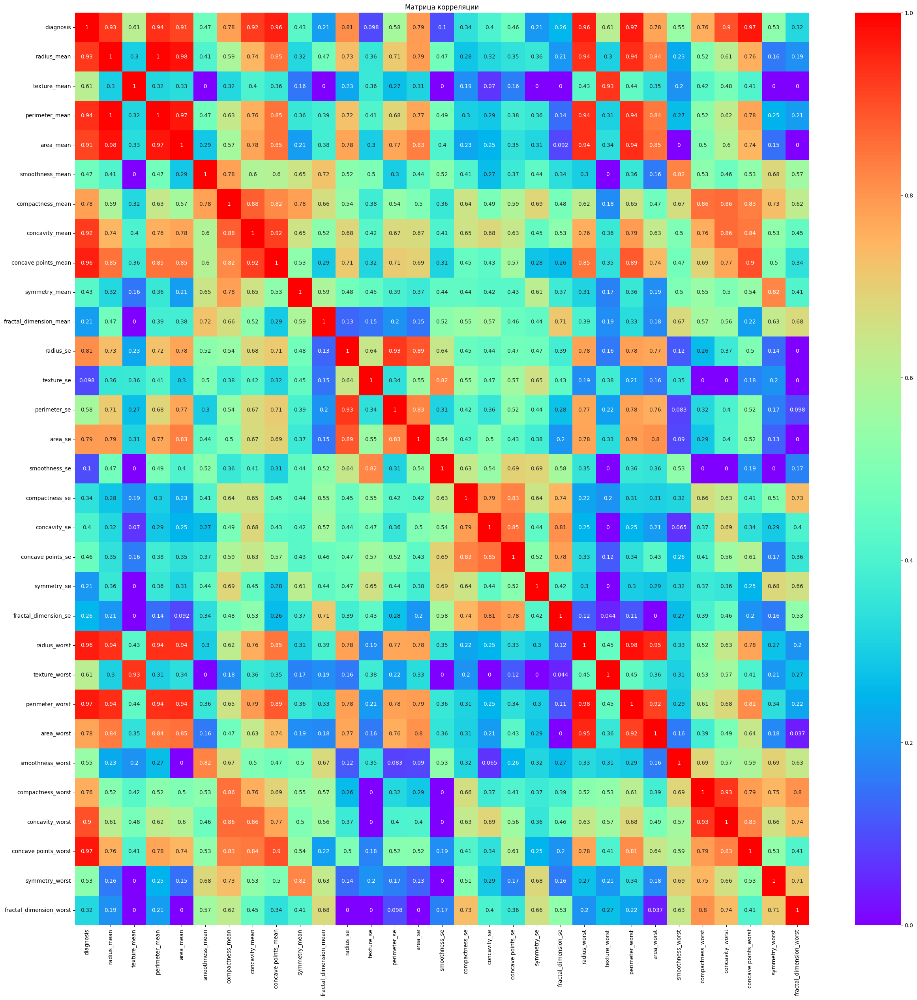

In [117]:
matrix = df.phik_matrix(interval_cols = cols_float)
plt.figure(figsize=(30,30))
sns.heatmap(matrix, annot=True, cmap='rainbow')
plt.title('Матрица корреляции')
plt.show()

In [120]:
df.drop(['radius_mean','concavity_mean','texture_se','concavity_worst'], inplace = True, axis = 1)

## Отбор признаков

In [178]:
! pip install scikit-learn

  Using cached scikit_learn-1.3.2-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (11.1 MB)
  Using cached threadpoolctl-3.5.0-py3-none-any.whl (18 kB)

[notice] A new release of pip is available: 23.0.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip


In [89]:
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split,cross_val_score
from sklearn.metrics import classification_report, confusion_matrix

In [6]:
y = df['diagnosis']
X = df.drop('diagnosis', axis = 1)
X_train,X_val, y_train, y_val = train_test_split(X,y,test_size=0.3, stratify=y)
model = RandomForestClassifier(random_state = random_state)
model.fit(X_train,y_train)
y_pred = model.predict(X_val)
print(classification_report(y_val,y_pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98       107
           1       0.97      0.97      0.97        64

    accuracy                           0.98       171
   macro avg       0.98      0.98      0.98       171
weighted avg       0.98      0.98      0.98       171



In [ ]:
model = RandomForestClassifier(random_state = random_state)


In [203]:
history_f1 = {}
history_raroc ={}
for i in range(2,df.shape[1]):
    model = RandomForestClassifier(random_state = random_state)
    selector = RFE(model, n_features_to_select= i)
    X_train_new = selector.fit_transform(X_train,y_train)
    f1_score = cross_val_score(model,X_train_new,y_train,cv = 5, scoring='f1').mean()
    history_f1[i] = f1_score
    

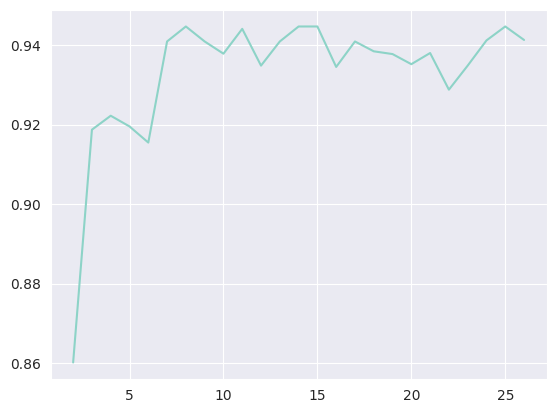

In [204]:
plt.plot(history_f1.keys(), history_f1.values())

In [223]:
idx_features = [ k for k in history_f1.keys() if history_f1[k] == max(history_f1.values())]
count_of_features = min(idx_features)

In [245]:
model = RandomForestClassifier(random_state = random_state)
selector = RFE(model, n_features_to_select= 15)
X_train_new = selector.fit_transform(X_train, y_train)
X_val_new = selector.transform(X_val)
model.fit(X_train_new,y_train)

RandomForestClassifier(random_state=42)

In [246]:
information = pd.DataFrame({'features' : selector.get_feature_names_out(), 'importance' : model.feature_importances_})
information = information.sort_values(by = 'importance', ascending=False)
information.reset_index(drop = True, inplace=True)

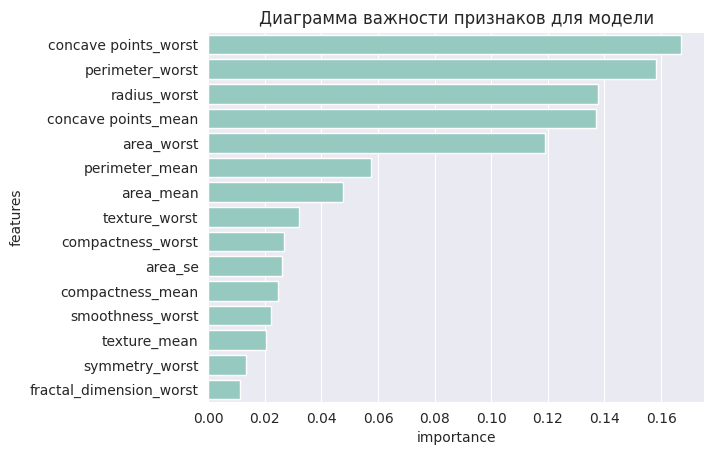

In [247]:
sns.barplot(y = information['features'],x =  information['importance'])
plt.title('Диаграмма важности признаков для модели')
plt.show()

In [249]:
y_pred = model.predict(X_val_new)
print(classification_report(y_val,y_pred))

              precision    recall  f1-score   support

           0       0.96      1.00      0.98       107
           1       1.00      0.92      0.96        64

    accuracy                           0.97       171
   macro avg       0.98      0.96      0.97       171
weighted avg       0.97      0.97      0.97       171



## Обучение моделей

In [251]:
!pip install xgboost lightgbm catboost -q


[notice] A new release of pip is available: 23.0.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip


In [8]:
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.model_selection import RandomizedSearchCV

In [39]:
y = df['diagnosis']
X = df.drop('diagnosis', axis = 1)
X_train,X_val, y_train, y_val = train_test_split(X,y,test_size=0.3, stratify=y)


model = RandomForestClassifier(random_state = random_state)
selector = RFE(model, n_features_to_select= 15)
X_train_new = selector.fit_transform(X_train, y_train)
X_val_new = selector.transform(X_val)

In [265]:
xgb = XGBClassifier(random_state = random_state, device = 'cuda',n_jobs = -1)

param_dist = {
    'n_estimators'     : [100,500, 800],
    'learning_rate'    : [1e-3, 1e-2,1e-1],
    'max_depth'        : [3,5, 10],
    'reg_lambda'       : [1e-3, 0.5,1,10],
    'reg_alpha'        : [1e-3 , 0.2,0.5,1]
}

In [266]:
rnd = RandomizedSearchCV(
        estimator          = xgb,
        param_distributions= param_dist,
        n_iter             = 60,              
        scoring            = 'f1',       
        cv                 = 5,
        verbose            = 2,
        n_jobs             = -1,
        random_state       = random_state
)

rnd.fit(X_train_new, y_train)

print("Лучшие параметры:", rnd.best_params_)
print("AUC (CV):",        rnd.best_score_)

Fitting 5 folds for each of 60 candidates, totalling 300 fits
[CV] END learning_rate=0.001, max_depth=3, n_estimators=500, reg_alpha=0.5, reg_lambda=10; total time=   0.6s
[CV] END learning_rate=0.001, max_depth=3, n_estimators=500, reg_alpha=0.5, reg_lambda=10; total time=   0.0s
[CV] END learning_rate=0.001, max_depth=None, n_estimators=500, reg_alpha=1, reg_lambda=1; total time=   0.0s
[CV] END learning_rate=0.1, max_depth=10, n_estimators=100, reg_alpha=0.5, reg_lambda=0.001; total time=   0.0s
[CV] END learning_rate=0.01, max_depth=10, n_estimators=800, reg_alpha=0.001, reg_lambda=10; total time=   0.0s
[CV] END learning_rate=0.1, max_depth=10, n_estimators=500, reg_alpha=1, reg_lambda=1; total time=   0.0s
[CV] END learning_rate=0.01, max_depth=None, n_estimators=100, reg_alpha=0.5, reg_lambda=1; total time=   0.0s
[CV] END learning_rate=0.01, max_depth=None, n_estimators=100, reg_alpha=0.2, reg_lambda=0.001; total time=   0.0s
[CV] END learning_rate=0.01, max_depth=3, n_estimato

/home/alex_kondrashov7/airflow1/lib/python3.8/site-packages/xgboost/core.py:158: UserWarning: [22:07:45] WARNING: /workspace/src/common/error_msg.cc:58: Falling back to prediction using DMatrix due to mismatched devices. This might lead to higher memory usage and slower performance. XGBoost is running on: cuda:0, while the input data is on: cpu.
Potential solutions:
- Use a data structure that matches the device ordinal in the booster.
- Set the device for booster before call to inplace_predict.

This warning will only be shown once.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.1, max_depth=10, n_estimators=800, reg_alpha=0.5, reg_lambda=0.001; total time=   6.8s
[CV] END learning_rate=0.001, max_depth=5, n_estimators=500, reg_alpha=0.5, reg_lambda=10; total time=   6.3s
[CV] END learning_rate=0.001, max_depth=3, n_estimators=500, reg_alpha=1, reg_lambda=1; total time=   5.6s
[CV] END learning_rate=0.01, max_depth=10, n_estimators=800, reg_alpha=0.001, reg_lambda=10; total time=  12.5s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=0.2, reg_lambda=0.001; total time=   1.2s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=0.5, reg_lambda=0.5; total time=   1.1s
[CV] END learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.2, reg_lambda=10; total time=   1.9s
[CV] END learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.2, reg_lambda=10; total time=   1.5s
[CV] END learning_rate=0.1, max_depth=3, n_estimators=800, reg_alpha=1, reg_lambda=1; total time=   5.7s
[CV] END learn

/home/alex_kondrashov7/airflow1/lib/python3.8/site-packages/xgboost/core.py:158: UserWarning: [22:07:43] WARNING: /workspace/src/common/error_msg.cc:58: Falling back to prediction using DMatrix due to mismatched devices. This might lead to higher memory usage and slower performance. XGBoost is running on: cuda:0, while the input data is on: cpu.
Potential solutions:
- Use a data structure that matches the device ordinal in the booster.
- Set the device for booster before call to inplace_predict.

This warning will only be shown once.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.001, max_depth=5, n_estimators=100, reg_alpha=0.5, reg_lambda=0.001; total time=   0.0s
[CV] END learning_rate=0.001, max_depth=5, n_estimators=800, reg_alpha=0.001, reg_lambda=1; total time=   0.0s
[CV] END learning_rate=0.1, max_depth=10, n_estimators=800, reg_alpha=0.5, reg_lambda=0.001; total time=   7.9s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=800, reg_alpha=0.2, reg_lambda=0.001; total time=   9.7s
[CV] END learning_rate=0.1, max_depth=10, n_estimators=100, reg_alpha=0.5, reg_lambda=0.001; total time=   1.4s
[CV] END learning_rate=0.01, max_depth=10, n_estimators=800, reg_alpha=0.001, reg_lambda=10; total time=  12.9s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=0.2, reg_lambda=0.001; total time=   1.4s
[CV] END learning_rate=0.001, max_depth=5, n_estimators=500, reg_alpha=0.2, reg_lambda=1; total time=   7.5s
[CV] END learning_rate=0.001, max_depth=3, n_estimators=800, reg_alpha=0.2, reg_lambda=10; total time=   9.

/home/alex_kondrashov7/airflow1/lib/python3.8/site-packages/xgboost/core.py:158: UserWarning: [22:07:44] WARNING: /workspace/src/common/error_msg.cc:58: Falling back to prediction using DMatrix due to mismatched devices. This might lead to higher memory usage and slower performance. XGBoost is running on: cuda:0, while the input data is on: cpu.
Potential solutions:
- Use a data structure that matches the device ordinal in the booster.
- Set the device for booster before call to inplace_predict.

This warning will only be shown once.

  warnings.warn(smsg, UserWarning)


[CV] END learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=0.5, reg_lambda=0.5; total time=   1.1s
[CV] END learning_rate=0.001, max_depth=5, n_estimators=500, reg_alpha=0.2, reg_lambda=1; total time=   6.2s
[CV] END learning_rate=0.001, max_depth=3, n_estimators=800, reg_alpha=0.2, reg_lambda=10; total time=   9.0s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=500, reg_alpha=1, reg_lambda=0.5; total time=   5.6s
[CV] END learning_rate=0.001, max_depth=5, n_estimators=500, reg_alpha=0.5, reg_lambda=0.001; total time=   7.1s
[CV] END learning_rate=0.01, max_depth=10, n_estimators=800, reg_alpha=0.5, reg_lambda=0.001; total time=  10.8s
[CV] END learning_rate=0.01, max_depth=10, n_estimators=800, reg_alpha=1, reg_lambda=1; total time=  13.3s
[CV] END learning_rate=0.1, max_depth=10, n_estimators=800, reg_alpha=0.5, reg_lambda=1; total time=   8.1s
[CV] END learning_rate=0.1, max_depth=3, n_estimators=800, reg_alpha=1, reg_lambda=10; total time=   9.0s
[CV] END learnin

/home/alex_kondrashov7/airflow1/lib/python3.8/site-packages/xgboost/core.py:158: UserWarning: [22:07:43] WARNING: /workspace/src/common/error_msg.cc:58: Falling back to prediction using DMatrix due to mismatched devices. This might lead to higher memory usage and slower performance. XGBoost is running on: cuda:0, while the input data is on: cpu.
Potential solutions:
- Use a data structure that matches the device ordinal in the booster.
- Set the device for booster before call to inplace_predict.

This warning will only be shown once.

  warnings.warn(smsg, UserWarning)
/home/alex_kondrashov7/airflow1/lib/python3.8/site-packages/xgboost/core.py:158: UserWarning: [22:07:43] WARNING: /workspace/src/common/error_msg.cc:58: Falling back to prediction using DMatrix due to mismatched devices. This might lead to higher memory usage and slower performance. XGBoost is running on: cuda:0, while the input data is on: cpu.
Potential solutions:
- Use a data structure that matches the device ordinal 

[CV] END learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=0.5, reg_lambda=1; total time=   1.7s
[CV] END learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.001, reg_lambda=10; total time=   1.5s
[CV] END learning_rate=0.01, max_depth=3, n_estimators=100, reg_alpha=0.5, reg_lambda=0.5; total time=   1.1s
[CV] END learning_rate=0.001, max_depth=5, n_estimators=500, reg_alpha=0.2, reg_lambda=1; total time=   7.1s
[CV] END learning_rate=0.001, max_depth=3, n_estimators=800, reg_alpha=0.2, reg_lambda=10; total time=  10.3s
[CV] END learning_rate=0.1, max_depth=5, n_estimators=800, reg_alpha=1, reg_lambda=1; total time=   7.7s
[CV] END learning_rate=0.001, max_depth=3, n_estimators=100, reg_alpha=0.5, reg_lambda=0.5; total time=   1.2s
[CV] END learning_rate=0.001, max_depth=3, n_estimators=100, reg_alpha=0.5, reg_lambda=0.5; total time=   1.2s
[CV] END learning_rate=0.01, max_depth=10, n_estimators=800, reg_alpha=0.5, reg_lambda=0.001; total time=  11.3s
[CV] END lea

/home/alex_kondrashov7/airflow1/lib/python3.8/site-packages/xgboost/core.py:158: UserWarning: [22:07:44] WARNING: /workspace/src/common/error_msg.cc:58: Falling back to prediction using DMatrix due to mismatched devices. This might lead to higher memory usage and slower performance. XGBoost is running on: cuda:0, while the input data is on: cpu.
Potential solutions:
- Use a data structure that matches the device ordinal in the booster.
- Set the device for booster before call to inplace_predict.

This warning will only be shown once.

  warnings.warn(smsg, UserWarning)
/home/alex_kondrashov7/airflow1/lib/python3.8/site-packages/xgboost/core.py:158: UserWarning: [22:07:44] WARNING: /workspace/src/common/error_msg.cc:58: Falling back to prediction using DMatrix due to mismatched devices. This might lead to higher memory usage and slower performance. XGBoost is running on: cuda:0, while the input data is on: cpu.
Potential solutions:
- Use a data structure that matches the device ordinal 

In [267]:
print("Лучшие параметры:", rnd.best_params_)

Лучшие параметры: {'reg_lambda': 0.5, 'reg_alpha': 1, 'n_estimators': 800, 'max_depth': 10, 'learning_rate': 0.01}


In [268]:
print("AUC (CV):",        rnd.best_score_)

AUC (CV): 0.9557900687274999


In [10]:
ctb = CatBoostClassifier(random_state=random_state,devices='0',task_type = 'GPU',eval_metric='F1',thread_count=4,allow_writing_files=True,used_ram_limit='8gb')
ctb_dist = {'iterations' : [100,500,1000],
            'learning_rate' : [1e-3,1e-2,1e-1],
            'depth' : [3,5,10],
            'l2_leaf_reg' : [1e-3,0.5,1]}
            

In [11]:
rnd = RandomizedSearchCV(
        estimator          = ctb,
        param_distributions= ctb_dist,
        n_iter             = 30,              
        scoring            = 'f1',       
        cv                 = 5,
        verbose            = 2,
        n_jobs             = 3,
        random_state       = random_state
)

In [12]:
rnd.fit(X_train_new,y_train)

Fitting 5 folds for each of 30 candidates, totalling 150 fits
0:	learn: 0.9561404	total: 7.82s	remaining: 12m 54s
1:	learn: 0.9603524	total: 7.82s	remaining: 6m 23s
2:	learn: 0.9741379	total: 7.83s	remaining: 4m 13s
3:	learn: 0.9741379	total: 7.83s	remaining: 3m 7s
4:	learn: 0.9741379	total: 7.84s	remaining: 2m 28s
5:	learn: 0.9741379	total: 7.84s	remaining: 2m 2s
6:	learn: 0.9827586	total: 7.84s	remaining: 1m 44s
7:	learn: 0.9741379	total: 7.85s	remaining: 1m 30s
8:	learn: 0.9696970	total: 7.85s	remaining: 1m 19s
9:	learn: 0.9741379	total: 7.86s	remaining: 1m 10s
10:	learn: 0.9741379	total: 7.86s	remaining: 1m 3s
11:	learn: 0.9783550	total: 7.86s	remaining: 57.7s
12:	learn: 0.9783550	total: 7.87s	remaining: 52.6s
13:	learn: 0.9783550	total: 7.87s	remaining: 48.3s
14:	learn: 0.9783550	total: 7.87s	remaining: 44.6s
15:	learn: 0.9783550	total: 7.88s	remaining: 41.3s
16:	learn: 0.9783550	total: 7.88s	remaining: 38.5s
17:	learn: 0.9783550	total: 7.88s	remaining: 35.9s
18:	learn: 0.9783550	

RandomizedSearchCV(cv=5,
                   estimator=<catboost.core.CatBoostClassifier object at 0x74ec8426ca30>,
                   n_iter=30, n_jobs=3,
                   param_distributions={'depth': [3, 5, 10],
                                        'iterations': [100, 500, 1000],
                                        'l2_leaf_reg': [0.001, 0.5, 1],
                                        'learning_rate': [0.001, 0.01, 0.1]},
                   random_state=42, scoring='f1', verbose=2)

410:	learn: 0.9739130	total: 1m 24s	remaining: 18.3s
411:	learn: 0.9739130	total: 1m 24s	remaining: 18.1s
412:	learn: 0.9739130	total: 1m 24s	remaining: 17.8s
413:	learn: 0.9739130	total: 1m 24s	remaining: 17.6s
414:	learn: 0.9739130	total: 1m 24s	remaining: 17.4s
415:	learn: 0.9739130	total: 1m 24s	remaining: 17.1s
416:	learn: 0.9739130	total: 1m 29s	remaining: 17.8s
417:	learn: 0.9739130	total: 1m 29s	remaining: 17.5s
418:	learn: 0.9739130	total: 1m 29s	remaining: 17.3s
419:	learn: 0.9739130	total: 1m 29s	remaining: 17s
420:	learn: 0.9739130	total: 1m 29s	remaining: 16.8s
421:	learn: 0.9739130	total: 1m 29s	remaining: 16.5s
422:	learn: 0.9739130	total: 1m 29s	remaining: 16.3s
423:	learn: 0.9739130	total: 1m 29s	remaining: 16s
424:	learn: 0.9739130	total: 1m 29s	remaining: 15.8s
425:	learn: 0.9739130	total: 1m 29s	remaining: 15.6s
426:	learn: 0.9739130	total: 1m 29s	remaining: 15.3s
427:	learn: 0.9739130	total: 1m 29s	remaining: 15.1s
428:	learn: 0.9739130	total: 1m 29s	remaining: 14.

344:	learn: 0.9785408	total: 11.3s	remaining: 5.25s
345:	learn: 0.9785408	total: 11.3s	remaining: 5.21s
346:	learn: 0.9785408	total: 11.4s	remaining: 5.17s
347:	learn: 0.9785408	total: 11.4s	remaining: 5.13s
348:	learn: 0.9785408	total: 11.4s	remaining: 5.1s
349:	learn: 0.9785408	total: 11.4s	remaining: 5.06s
350:	learn: 0.9785408	total: 11.5s	remaining: 5.03s
351:	learn: 0.9785408	total: 11.5s	remaining: 5s
352:	learn: 0.9785408	total: 11.5s	remaining: 4.96s
353:	learn: 0.9785408	total: 11.6s	remaining: 4.92s
354:	learn: 0.9785408	total: 11.6s	remaining: 4.88s
355:	learn: 0.9785408	total: 11.6s	remaining: 4.85s
356:	learn: 0.9785408	total: 11.6s	remaining: 4.81s
357:	learn: 0.9785408	total: 11.7s	remaining: 4.79s
358:	learn: 0.9785408	total: 11.7s	remaining: 4.76s
359:	learn: 0.9785408	total: 11.8s	remaining: 4.72s
360:	learn: 0.9785408	total: 11.8s	remaining: 4.68s
361:	learn: 0.9785408	total: 11.8s	remaining: 4.64s
362:	learn: 0.9785408	total: 11.9s	remaining: 4.62s
363:	learn: 0.97

353:	learn: 0.9785408	total: 10s	remaining: 4.17s
354:	learn: 0.9785408	total: 10s	remaining: 4.13s
355:	learn: 0.9785408	total: 10.1s	remaining: 4.1s
356:	learn: 0.9785408	total: 10.1s	remaining: 4.07s
357:	learn: 0.9785408	total: 10.1s	remaining: 4.04s
358:	learn: 0.9785408	total: 10.1s	remaining: 4.01s
359:	learn: 0.9785408	total: 10.2s	remaining: 3.98s
360:	learn: 0.9785408	total: 10.2s	remaining: 3.95s
361:	learn: 0.9785408	total: 10.2s	remaining: 3.92s
362:	learn: 0.9785408	total: 10.2s	remaining: 3.89s
363:	learn: 0.9785408	total: 10.3s	remaining: 3.86s
364:	learn: 0.9785408	total: 10.4s	remaining: 3.87s
365:	learn: 0.9785408	total: 10.4s	remaining: 3.84s
366:	learn: 0.9785408	total: 10.5s	remaining: 3.82s
367:	learn: 0.9785408	total: 10.5s	remaining: 3.8s
368:	learn: 0.9785408	total: 10.5s	remaining: 3.77s
369:	learn: 0.9785408	total: 10.6s	remaining: 3.75s
370:	learn: 0.9785408	total: 10.6s	remaining: 3.72s
371:	learn: 0.9785408	total: 10.7s	remaining: 3.69s
372:	learn: 0.9785

In [14]:
rnd.best_params_

{'learning_rate': 0.1, 'l2_leaf_reg': 0.001, 'iterations': 1000, 'depth': 5}

In [17]:
lgb = LGBMClassifier(random_state=random_state,n_jobs=-1)
lgb.fit(X_train_new, y_train)
cross_val_score(lgb, X_train_new,y_train, cv=5).mean()

[LightGBM] [Info] Number of positive: 148, number of negative: 250
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000675 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1989
[LightGBM] [Info] Number of data points in the train set: 398, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.371859 -> initscore=-0.524249
[LightGBM] [Info] Start training from score -0.524249
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

0.9572784810126581

In [19]:
param_dist = {
    'learning_rate'    : [1e-3, 1e-2,1e-1],
    'max_depth'        : [3,5, 10],
    'reg_lambda'       : [1e-3, 0.5,1,10],
    'reg_alpha'        : [1e-3 , 0.2,0.5,1]
}

In [20]:
rnd = RandomizedSearchCV(
        estimator          = lgb,
        param_distributions= param_dist,
        n_iter             = 30,              
        scoring            = 'f1',       
        cv                 = 5,
        verbose            = 2,
        n_jobs             = -1,
        random_state       = random_state
)
rnd.fit(X_train_new,y_train)

Fitting 5 folds for each of 30 candidates, totalling 150 fits
[LightGBM] [Info] Number of positive: 118, number of negative: 200
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.223907 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1601
[LightGBM] [Info] Number of data points in the train set: 318, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.371069 -> initscore=-0.527633
[LightGBM] [Info] Start training from score -0.527633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


RandomizedSearchCV(cv=5, estimator=LGBMClassifier(random_state=42), n_iter=30,
                   n_jobs=-1,
                   param_distributions={'learning_rate': [0.001, 0.01, 0.1],
                                        'max_depth': [3, 5, 10],
                                        'reg_alpha': [0.001, 0.2, 0.5, 1],
                                        'reg_lambda': [0.001, 0.5, 1, 10]},
                   random_state=42, scoring='f1', verbose=2)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.251958 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1599
[LightGBM] [Info] Number of data points in the train set: 318, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.371069 -> initscore=-0.527633
[LightGBM] [Info] Start training from score -0.527633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

In [21]:
rnd.best_score_

0.9448293181883581

In [22]:
rnd.best_params_

{'reg_lambda': 0.001, 'reg_alpha': 0.2, 'max_depth': 3, 'learning_rate': 0.1}

In [62]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import VotingClassifier

[CV] END model__metric=manhattan, model__n_neighbors=49, model__p=1; total time=   0.0s
[CV] END model__metric=euclidean, model__n_neighbors=45, model__p=2; total time=   0.0s
[CV] END model__metric=cosine, model__n_neighbors=39, model__p=2; total time=   0.0s
[CV] END model__metric=cosine, model__n_neighbors=25, model__p=2; total time=   0.0s
[CV] END model__metric=manhattan, model__n_neighbors=7, model__p=2; total time=   0.0s
[CV] END model__metric=cosine, model__n_neighbors=20, model__p=2; total time=   0.0s
[CV] END model__metric=cosine, model__n_neighbors=20, model__p=2; total time=   0.0s
[CV] END model__metric=cosine, model__n_neighbors=15, model__p=2; total time=   0.0s
[CV] END model__metric=cosine, model__n_neighbors=15, model__p=2; total time=   0.0s
[CV] END model__metric=manhattan, model__n_neighbors=19, model__p=2; total time=   0.0s
[CV] END model__metric=manhattan, model__n_neighbors=19, model__p=2; total time=   0.0s
[CV] END model__metric=manhattan, model__n_neighbor

In [56]:
X_train_new = pd.DataFrame(X_train_new, columns = selector.get_feature_names_out())

,texture_mean,perimeter_mean,area_mean,compactness_mean,concave_points_mean,radius_se,perimeter_se,area_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concave_points_worst
0,25.11,124.80,1088.0,0.18870,0.12440,0.8307,5.574,105.00,23.15,34.01,160.50,1670.0,0.1491,0.4257,0.18480
1,19.08,113.40,895.0,0.15720,0.10900,0.2959,2.153,31.98,19.59,24.89,133.50,1189.0,0.1703,0.3934,0.25430
2,20.53,92.41,618.4,0.11080,0.03058,0.3478,2.749,31.01,16.45,27.26,112.10,828.5,0.1153,0.3429,0.13390
3,13.14,64.12,272.5,0.22040,0.07038,0.2744,1.787,17.67,10.60,18.04,69.47,328.1,0.2006,0.3663,0.10750
4,16.02,75.46,408.2,0.11680,0.04497,0.2456,1.667,15.89,12.64,19.67,81.93,475.7,0.1415,0.2170,0.11050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
393,9.71,68.77,357.6,0.05736,0.01698,0.1728,1.126,11.48,11.60,12.02,73.66,414.0,0.1436,0.1257,0.04603
394,16.34,87.21,571.8,0.06059,0.01723,0.1872,1.449,14.55,14.67,23.19,96.08,656.7,0.1089,0.1582,0.08586
395,25.25,84.10,537.9,0.05205,0.02068,0.2084,1.314,17.58,14.35,34.23,91.29,632.9,0.1289,0.1063,0.06005
396,13.39,73.00,384.8,0.11360,0.04796,0.3384,1.851,26.33,11.92,15.77,76.53,434.0,0.1367,0.1822,0.08611


In [57]:
intervals_cols = selector.get_feature_names_out()
transformer = ColumnTransformer(transformers=[
    ('scl',StandardScaler(),intervals_cols)],remainder='passthrough')
pipe4 = Pipeline(steps=[
    ('transformer',transformer),
    ('model',KNeighborsClassifier(n_jobs=-1) )])

In [58]:
param_dist = {'model__n_neighbors' : np.arange(3,50),
              'model__p' : [1,2], 
              'model__metric' : ['manhattan','euclidean','cosine']}

In [59]:
rnd = RandomizedSearchCV(
        estimator          = pipe4,
        param_distributions= param_dist,
        n_iter             = 60,              
        scoring            = 'f1',       
        cv                 = 5,
        verbose            = 2,
        n_jobs             = -1,
        random_state       = random_state
)

rnd.fit(X_train_new, y_train)

Fitting 5 folds for each of 60 candidates, totalling 300 fits


RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('transformer',
                                              ColumnTransformer(remainder='passthrough',
                                                                transformers=[('scl',
                                                                               StandardScaler(),
                                                                               array(['texture_mean', 'perimeter_mean', 'area_mean', 'compactness_mean',
       'concave_points_mean', 'radius_se', 'perimeter_se', 'area_se',
       'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst',
       'smoothness_wo...
                                             ('model',
                                              KNeighborsClassifier(n_jobs=-1))]),
                   n_iter=60, n_jobs=-1,
                   param_distributions={'model__metric': ['manhattan',
                                                          'euclidean',
                                                          'cosine'],
                                        'model__n_neighbors': array([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
       20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36,
       37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]),
                                        'model__p': [1, 2]},
                   random_state=42, scoring='f1', verbose=2)

In [61]:
rnd.best_params_

{'model__p': 1, 'model__n_neighbors': 14, 'model__metric': 'manhattan'}

In [63]:
xgb = XGBClassifier(random_state = random_state, device = 'cuda',n_jobs = -1, reg_lambda  =0.5, reg_alpha = 1, n_estimators = 800, max_depth = 10, learning_rate = 0.01)
xgb.fit(X_train_new,y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cuda', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.01, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=10, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=800, n_jobs=-1,
              num_parallel_tree=None, random_state=42, ...)

In [67]:
ctb = CatBoostClassifier(random_state=random_state,devices='0',task_type = 'GPU',eval_metric='F1',thread_count=4,allow_writing_files=True,used_ram_limit='8gb',
                        learning_rate = 0.1,l2_leaf_reg = 0.001,iterations = 1000, depth = 5 )
ctb.fit(X_train_new,y_train)

0:	learn: 0.9652778	total: 85.4ms	remaining: 1m 25s
1:	learn: 0.9793103	total: 116ms	remaining: 57.7s
2:	learn: 0.9793103	total: 145ms	remaining: 48.3s
3:	learn: 0.9863014	total: 175ms	remaining: 43.7s
4:	learn: 0.9897611	total: 205ms	remaining: 40.7s
5:	learn: 0.9966102	total: 237ms	remaining: 39.2s
6:	learn: 0.9966102	total: 267ms	remaining: 37.8s
7:	learn: 0.9966102	total: 361ms	remaining: 44.8s
8:	learn: 0.9966102	total: 392ms	remaining: 43.1s
9:	learn: 0.9966102	total: 434ms	remaining: 43s
10:	learn: 0.9966102	total: 492ms	remaining: 44.2s
11:	learn: 0.9966102	total: 550ms	remaining: 45.3s
12:	learn: 1.0000000	total: 581ms	remaining: 44.1s
13:	learn: 1.0000000	total: 612ms	remaining: 43.1s
14:	learn: 1.0000000	total: 645ms	remaining: 42.3s
15:	learn: 1.0000000	total: 675ms	remaining: 41.5s
16:	learn: 1.0000000	total: 707ms	remaining: 40.9s
17:	learn: 1.0000000	total: 737ms	remaining: 40.2s
18:	learn: 1.0000000	total: 836ms	remaining: 43.1s
19:	learn: 1.0000000	total: 924ms	remaini

In [69]:
lgb = LGBMClassifier(random_state=random_state,n_jobs=-1, reg_lambda = 0.001,reg_alpha = 0.2,max_depth = 3,learning_rate = 0.1)
lgb.fit(X_train_new, y_train)

[LightGBM] [Info] Number of positive: 148, number of negative: 250
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000741 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1989
[LightGBM] [Info] Number of data points in the train set: 398, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.371859 -> initscore=-0.524249
[LightGBM] [Info] Start training from score -0.524249
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

LGBMClassifier(max_depth=3, n_jobs=-1, random_state=42, reg_alpha=0.2,
               reg_lambda=0.001)

In [70]:
rdf = RandomForestClassifier(random_state = random_state)
rdf.fit(X_train_new, y_train)
#voting_model = VotingClassifier(estimators=[('rdf',pipe),('xgb',pipe2),('knn',pipe4),('lgb',pipe3)],voting='soft')

RandomForestClassifier(random_state=42)

In [72]:
intervals_cols = selector.get_feature_names_out()
transformer = ColumnTransformer(transformers=[
    ('scl',StandardScaler(),intervals_cols)],remainder='passthrough')
knn = Pipeline(steps=[
    ('transformer',transformer),
    ('model',KNeighborsClassifier(n_jobs=-1,p =1, n_neighbors=14, metric = 'manhattan' ) )])

knn.fit(X_train_new,y_train)


Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('scl', StandardScaler(),
                                                  array(['texture_mean', 'perimeter_mean', 'area_mean', 'compactness_mean',
       'concave_points_mean', 'radius_se', 'perimeter_se', 'area_se',
       'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst',
       'smoothness_worst', 'compactness_worst', 'concave_points_worst'],
      dtype=object))])),
                ('model',
                 KNeighborsClassifier(metric='manhattan', n_jobs=-1,
                                      n_neighbors=14, p=1))])

In [80]:
voting_model = VotingClassifier(estimators=[('ctb',ctb),('xgb',xgb),('knn',knn)],voting='soft')

In [81]:
voting_model.fit(X_train_new,y_train)

0:	learn: 0.9652778	total: 30.7ms	remaining: 30.7s
1:	learn: 0.9793103	total: 57.3ms	remaining: 28.6s
2:	learn: 0.9793103	total: 83ms	remaining: 27.6s
3:	learn: 0.9863014	total: 112ms	remaining: 28s
4:	learn: 0.9897611	total: 139ms	remaining: 27.6s
5:	learn: 0.9966102	total: 165ms	remaining: 27.3s
6:	learn: 0.9966102	total: 192ms	remaining: 27.2s
7:	learn: 0.9966102	total: 218ms	remaining: 27s
8:	learn: 0.9966102	total: 249ms	remaining: 27.4s
9:	learn: 0.9966102	total: 275ms	remaining: 27.2s
10:	learn: 0.9966102	total: 303ms	remaining: 27.2s
11:	learn: 0.9966102	total: 330ms	remaining: 27.1s
12:	learn: 1.0000000	total: 356ms	remaining: 27s
13:	learn: 1.0000000	total: 383ms	remaining: 27s
14:	learn: 1.0000000	total: 410ms	remaining: 26.9s
15:	learn: 1.0000000	total: 436ms	remaining: 26.8s
16:	learn: 1.0000000	total: 465ms	remaining: 26.9s
17:	learn: 1.0000000	total: 491ms	remaining: 26.8s
18:	learn: 1.0000000	total: 518ms	remaining: 26.8s
19:	learn: 1.0000000	total: 545ms	remaining: 26.

VotingClassifier(estimators=[('ctb',
                              <catboost.core.CatBoostClassifier object at 0x74e9ae535d30>),
                             ('xgb',
                              XGBClassifier(base_score=None, booster=None,
                                            callbacks=None,
                                            colsample_bylevel=None,
                                            colsample_bynode=None,
                                            colsample_bytree=None,
                                            device='cuda',
                                            early_stopping_rounds=None,
                                            enable_categorical=False,
                                            eval_metric=None,
                                            feature_types=None, gamma=None,
                                            grow_policy...
                                                                                array(['texture_mean', 'perimeter_mean', 'area_mean', 'compactness_mean',
       'concave_points_mean', 'radius_se', 'perimeter_se', 'area_se',
       'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst',
       'smoothness_worst', 'compactness_worst', 'concave_points_worst'],
      dtype=object))])),
                                              ('model',
                                               KNeighborsClassifier(metric='manhattan',
                                                                    n_jobs=-1,
                                                                    n_neighbors=14,
                                                                    p=1))]))],
                 voting='soft')

In [82]:
cross_val_score(voting_model,X_train_new,y_train, cv = 5, scoring='f1').mean()

0:	learn: 0.9478261	total: 27.2ms	remaining: 27.1s
1:	learn: 0.9652174	total: 54ms	remaining: 26.9s
2:	learn: 0.9783550	total: 78.8ms	remaining: 26.2s
3:	learn: 0.9655172	total: 104ms	remaining: 25.9s
4:	learn: 0.9783550	total: 131ms	remaining: 26s
5:	learn: 0.9827586	total: 156ms	remaining: 25.8s
6:	learn: 0.9827586	total: 180ms	remaining: 25.6s
7:	learn: 0.9827586	total: 205ms	remaining: 25.4s
8:	learn: 0.9871245	total: 229ms	remaining: 25.2s
9:	learn: 0.9914530	total: 257ms	remaining: 25.4s
10:	learn: 0.9957447	total: 283ms	remaining: 25.5s
11:	learn: 0.9957447	total: 308ms	remaining: 25.3s
12:	learn: 0.9957447	total: 335ms	remaining: 25.4s
13:	learn: 0.9957447	total: 360ms	remaining: 25.4s
14:	learn: 1.0000000	total: 384ms	remaining: 25.2s
15:	learn: 1.0000000	total: 409ms	remaining: 25.1s
16:	learn: 1.0000000	total: 433ms	remaining: 25s
17:	learn: 1.0000000	total: 459ms	remaining: 25s
18:	learn: 1.0000000	total: 482ms	remaining: 24.9s
19:	learn: 1.0000000	total: 506ms	remaining: 2

0.9721510673234812

In [83]:


dump(voting_model, 'voting_model.pkl')

['voting_model.pkl']

In [84]:
dump(selector, 'selector_model.pkl')

['selector_model.pkl']

In [87]:
X_val_new = pd.DataFrame(X_val_new, columns = selector.get_feature_names_out())

y_pred = voting_model.predict(X_val_new)
print(classification_report(y_val, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.98      0.98       107
           1       0.97      0.95      0.96        64

    accuracy                           0.97       171
   macro avg       0.97      0.97      0.97       171
weighted avg       0.97      0.97      0.97       171



## Матрица предсказаний

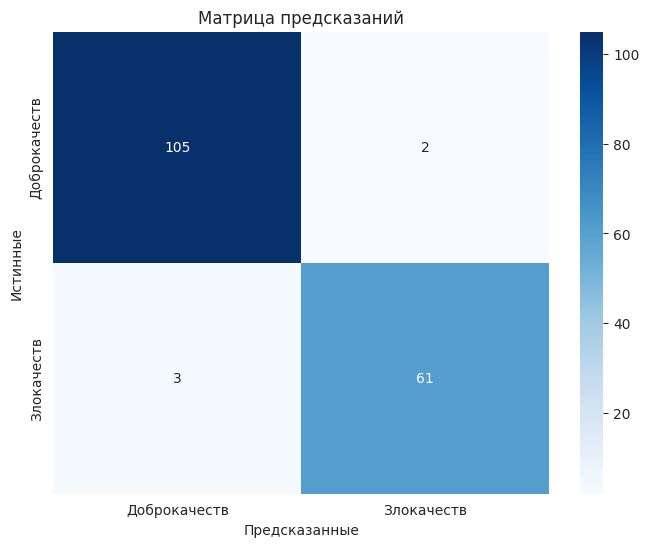

In [95]:
cm = confusion_matrix(y_val,y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',xticklabels=['Доброкачеств' , 'Злокачеств'],yticklabels=['Доброкачеств' , 'Злокачеств'] )
plt.xlabel('Предсказанные')
plt.ylabel('Истинные')
plt.title('Матрица предсказаний')
plt.show()